In [1]:
using thesis
using StatsPlots
using PRMaps
using PyCall
using Healpix
using Random, Distributions
using LinearAlgebra
using StructArrays

import Stripeline as Sl

In [2]:
a = Instrument(name = "cbass", frequency = 5.0, noisePerPixel = 72.0)
b = Instrument(name = "quijote_11", frequency = 11.0, noisePerPixel = 64.0)
c = Instrument(name = "quijote_13", frequency = 13.0, noisePerPixel = 90.0)
d = Instrument(name = "LSPE/Strip", frequency = 43.0, noisePerPixel = 1.8)

instruments = StructArray([a,b,c,d])

4-element StructArray(::Vector{String}, ::Vector{Float64}, ::Vector{Float64}) with eltype Instrument:
 Instrument("cbass", 5.0, 72.0)
 Instrument("quijote_11", 11.0, 64.0)
 Instrument("quijote_13", 13.0, 90.0)
 Instrument("LSPE/Strip", 43.0, 1.8)

In [3]:
nside = 64

cam_ang = Sl.CameraAngles()
 
setup = PRMaps.Setup(
    sampling_freq_Hz = 100,
    total_time_s = 24. * 3600. * 10.
    )
nothing

# Run simulation without the error

In [4]:
result = run_simulation(instruments, cam_ang, setup, nside)

┌ Info: Generating sky signal using pysm3
└ @ thesis /mnt/sda1/Università/Magistrale/Tesi/thesis/src/thesis.jl:183
┌ Info: Adding white noise based on the instruments sensitivity
└ @ thesis /mnt/sda1/Università/Magistrale/Tesi/thesis/src/thesis.jl:186


┌ Info: Simulating telescope scanning strategy [LSPE/Strip]
└ @ thesis /mnt/sda1/Università/Magistrale/Tesi/thesis/src/thesis.jl:191
┌ Info: Run component separation using fgbuster
└ @ thesis /mnt/sda1/Università/Magistrale/Tesi/thesis/src/thesis.jl:194


Dict{Any, Any} with 18 entries:
  "nit"       => 1
  "x"         => [1.54, 20.0, -3.0]
  "hess_inv"  => [1.00001 2.71146e-8 -0.000213719; 2.71146e-8 1.0 -4.58616e-7; …
  "chi_dB"    => [[-1.6375e30 -1.6375e30 … -1.6375e30 -1.6375e30; -1.6375e30 -1…
  "nfev"      => 35
  "status"    => 2
  "chi"       => [-1.6375e30 -1.6375e30; -1.6375e30 -1.6375e30; -1.6375e30 -1.6…
  "s"         => [-1.6375e30 -1.6375e30; -1.6375e30 -1.6375e30; -1.6375e30 -1.6…
  "njev"      => 24
  "mask_good" => Bool[0, 0, 0, 0, 0, 0, 0, 0, 0, 0  …  0, 0, 0, 0, 0, 0, 0, 0, …
  "success"   => false
  "params"    => ["Dust.beta_d", "Dust.temp", "Synchrotron.beta_pl"]
  "fun"       => -6.57643e10
  "Sigma"     => [4.38578e14 -2.04389e17 -8.56768e-5; -2.04389e17 9.52505e19 -0…
  "message"   => "Desired error not necessarily achieved due to precision loss."
  "Sigma_inv" => [3.65001 0.00783219 5408.32; 0.00783219 1.68063e-5 11.6052; 54…
  "jac"       => [-0.00699959, -1.50198e-5, -0.228287]
  "invAtNA"   => [0.85421 -17.

/home/matteo/.julia/packages/PyCall/ygXW2/src/pyeval.jl:39: RuntimeWarning: covariance is not positive-semidefinite.
  PyPtr, (PyPtr, PyPtr, PyPtr),


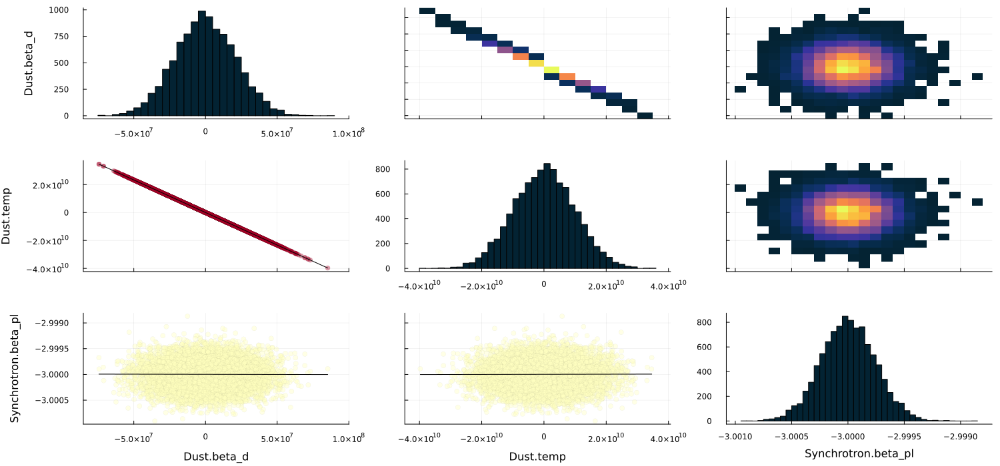

In [5]:
plot(get_corrplot(result))

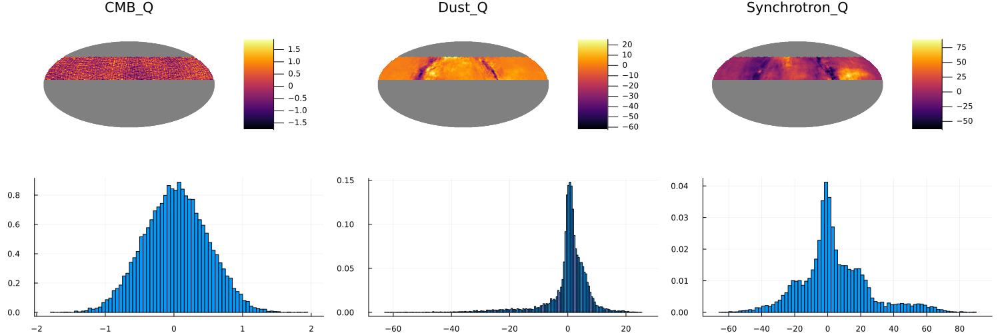

In [6]:
plot(get_map_and_hist(result, "Q", nside))

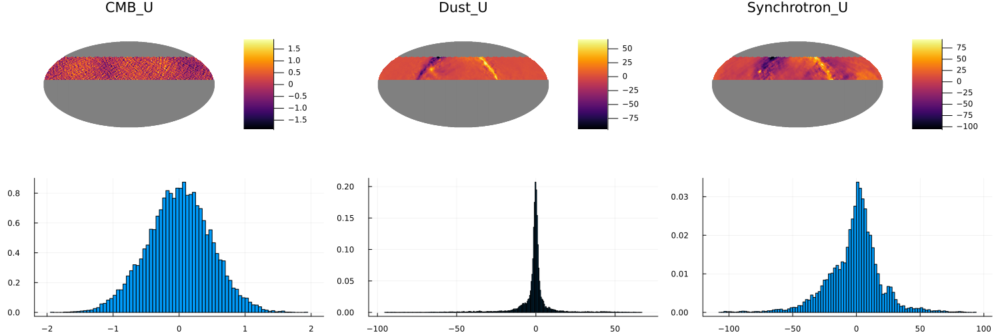

In [7]:
plot(get_map_and_hist(result, "U", nside))

# Run simulation with pointing error

In [9]:
tel_ang = Sl.TelescopeAngles(
    wheel2ang_0_rad = deg2rad(1.0)
)
nothing

In [10]:
result_with_error = run_simulation_with_error(instruments, cam_ang, tel_ang, setup, nside)

┌ Info: Generating sky signal using pysm3
└ @ thesis /mnt/sda1/Università/Magistrale/Tesi/thesis/src/thesis.jl:214
┌ Info: Adding white noise based on the instruments sensitivity
└ @ thesis /mnt/sda1/Università/Magistrale/Tesi/thesis/src/thesis.jl:218


┌ Info: Simulating telescope scanning strategy [LSPE/Strip WITH pointing error]
└ @ thesis /mnt/sda1/Università/Magistrale/Tesi/thesis/src/thesis.jl:226
┌ Info: Run component separation using fgbuster
└ @ thesis /mnt/sda1/Università/Magistrale/Tesi/thesis/src/thesis.jl:234


Dict{Any, Any} with 18 entries:
  "nit"       => 16
  "x"         => [10.134, 18.7157, -3.00054]
  "hess_inv"  => [0.000631435 -0.0456271 3.80811e-6; -0.0456271 3.79759 -0.0002…
  "chi_dB"    => [[-1.6375e30 -1.6375e30 … -1.6375e30 -1.6375e30; -1.6375e30 -1…
  "nfev"      => 60
  "status"    => 2
  "chi"       => [-1.6375e30 -1.6375e30; -1.6375e30 -1.6375e30; -1.6375e30 -1.6…
  "s"         => [-1.6375e30 -1.6375e30; -1.6375e30 -1.6375e30; -1.6375e30 -1.6…
  "njev"      => 49
  "mask_good" => Bool[0, 0, 0, 0, 0, 0, 0, 0, 0, 0  …  0, 0, 0, 0, 0, 0, 0, 0, …
  "success"   => false
  "params"    => ["Dust.beta_d", "Dust.temp", "Synchrotron.beta_pl"]
  "fun"       => -6.57643e10
  "Sigma"     => [-8.01652e22 -6.67758e24 -1584.41; -6.67758e24 -5.56228e26 -1.…
  "message"   => "Desired error not necessarily achieved due to precision loss."
  "Sigma_inv" => [6.12155e-8 -7.34899e-10 0.174443; -7.34899e-10 8.82255e-12 -0…
  "jac"       => [-0.0189175, 0.000227106, -0.863935]
  "invAtNA"   => [0.5

/home/matteo/.julia/packages/PyCall/ygXW2/src/pyeval.jl:39: RuntimeWarning: covariance is not positive-semidefinite.
  PyPtr, (PyPtr, PyPtr, PyPtr),


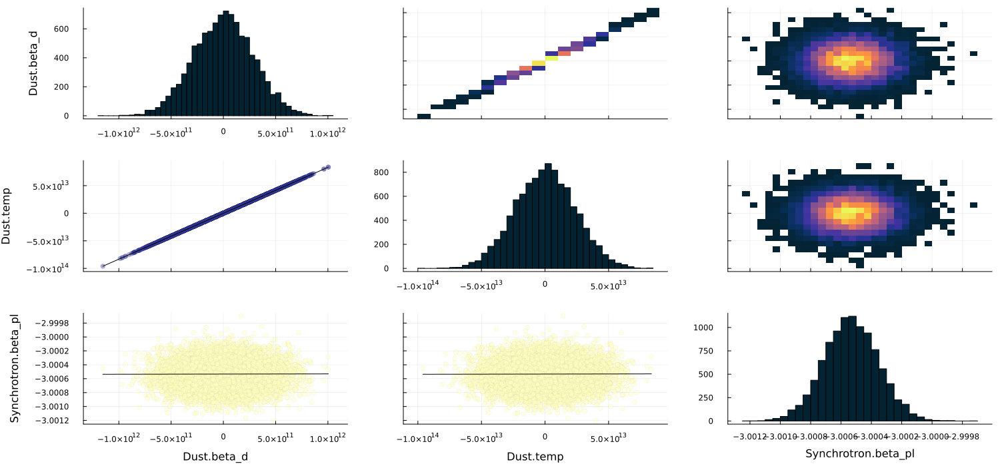

In [11]:
plot(get_corrplot(result_with_error))

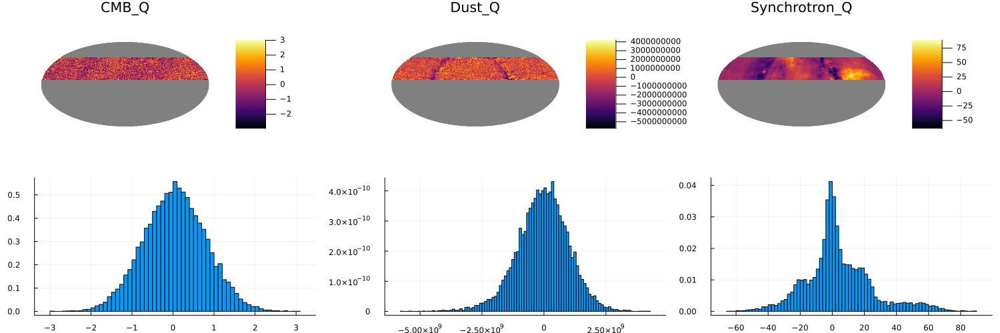

In [12]:
plot(get_map_and_hist(result_with_error, "Q", nside))

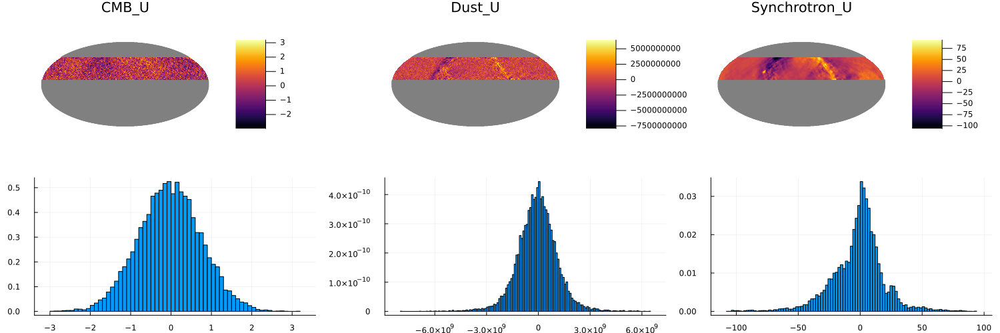

In [13]:
plot(get_map_and_hist(result_with_error, "U", nside))